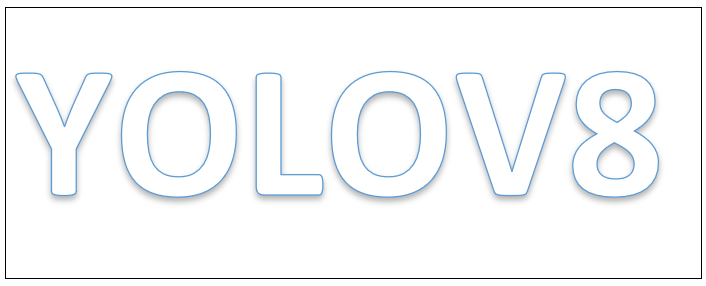

# **CONNECTION AND CONFIGURATION**

In [1]:
# Check if NVIDIA GPU is enabled
!nvidia-smi

Tue Feb  7 16:43:32 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   53C    P0    25W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
import torch
import os
import glob
import  shutil
from IPython import display
from IPython.display import Image, clear_output  # to display images
from sklearn.model_selection import train_test_split


In [3]:
#Conecting with google drive
from google.colab import drive
drive.mount('/content/gdrive')
!ln -s /content/gdrive/My\ Drive/ /mydrive

Mounted at /content/gdrive


## Install Requirements

YOLOv8 can be installed in two ways - from the source and via pip. This is because it is the first iteration of YOLO to have an official package.

In [7]:
!pip install ultralytics
from ultralytics import YOLO

display.clear_output()
!yolo checks

Ultralytics YOLOv8.0.30 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 23.6/78.2 GB disk)


#**DATASET**

The images and label are save into drive, we'll automatically create the necesary directories and copy into the right folder.



```
Dataset directory format

content/yolov5/data____train___images
                  |      |_____labels
                  |
                  |____val_____images
                  |      |_____labels
                  |
                  |____test___images
                         |_____labels


```


In [8]:
image_path = '/content/gdrive/MyDrive/yolov8'

In [12]:
!mkdir data
!mkdir data/obj
!unzip {image_path}/dataset.zip -d data/obj  

Archive:  /content/gdrive/MyDrive/yolov8/dataset.zip
  inflating: data/obj/dataset/m13-m14-0000.jpg  
  inflating: data/obj/dataset/m13-m14-0000.txt  
  inflating: data/obj/dataset/m13-m14-0022.jpg  
  inflating: data/obj/dataset/m13-m14-0022.txt  
  inflating: data/obj/dataset/m13-m14-0025.jpg  
  inflating: data/obj/dataset/m13-m14-0025.txt  
  inflating: data/obj/dataset/m13-m14-0028.jpg  
  inflating: data/obj/dataset/m13-m14-0028.txt  
  inflating: data/obj/dataset/m13-m14-0031.jpg  
  inflating: data/obj/dataset/m13-m14-0031.txt  
  inflating: data/obj/dataset/m13-m14-0034.jpg  
  inflating: data/obj/dataset/m13-m14-0034.txt  
  inflating: data/obj/dataset/m13-m14-0037.jpg  
  inflating: data/obj/dataset/m13-m14-0037.txt  
  inflating: data/obj/dataset/m13-m14-0040.jpg  
  inflating: data/obj/dataset/m13-m14-0040.txt  
  inflating: data/obj/dataset/m13-m14-0043.jpg  
  inflating: data/obj/dataset/m13-m14-0043.txt  
  inflating: data/obj/dataset/m13-m14-0046.jpg  
  inflating: dat

In [13]:
image_path = os.getcwd()

##Split into train, tests and validation

In [14]:
images_list = glob.glob(f"{image_path}/data/obj/dataset/*.jpg")
label_list = glob.glob(f"{image_path}/data/obj/dataset/*.txt")


In [15]:
images_list.sort()
label_list.sort()

# Split the dataset into train-valid-test splits 
train_images, val_images, train_annotations, val_annotations = train_test_split(images_list, label_list, test_size = 0.2, random_state = 1)
val_images, test_images, val_annotations, test_annotations = train_test_split(val_images, val_annotations, test_size = 0.5, random_state = 1)

In [16]:
%cd {image_path}/data

!mkdir train   test   val
!mkdir train/images  train/labels   test/images  test/labels  val/images  val/labels


/content/data


In [17]:
#Utility function to move images 
def move_files_to_folder(list_of_files, destination_folder):
    for f in list_of_files:
        try:
            shutil.move(f, destination_folder)
        except:
            print(f)
            assert False

# Move the splits into their folders

move_files_to_folder(train_images, './train/images/')
move_files_to_folder(val_images, './val/images/')
move_files_to_folder(test_images, './test/images/')
move_files_to_folder(train_annotations, './train/labels/')
move_files_to_folder(val_annotations, './val/labels/')
move_files_to_folder(test_annotations, './test/labels/')

%cd ../

/content


In [18]:
print("Number of training images:", len(os.listdir(f'{image_path}/data/train/images')))
print("Number of test images:", len(os.listdir(f'{image_path}/data/test/images')))
print("Number of validation images:", len(os.listdir(f'{image_path}/data/val/images')))

Number of training images: 254
Number of test images: 32
Number of validation images: 32


###*Create .yalm file*

Create file data.yalm in the directory .\yolov8\data\, containing (where classes = number of objects): 

* names:['object']
* nc: 1
* test : data/test
* train  : data/train
* val  : data/val


In [20]:
!echo -e 'names: ["maiz14"]\nnc: 1\ntest: /content/data/test\ntrain : /content/data/train\nval: /content/data/val'> data/data.yaml

#**PRETRAINED WEIGHTS**

The weigth will be automaticaly download in the training sentence

#**TRAIN**

<font color='RED'>*RUN THE METRIC CELL TO FOLLOW TRAINING*</font>

For training 
```
yolo task=detect    mode=train    model=yolov8n.pt    data = data.yalm  epochs=1  imgsz=640
            ...           ...           ...
          segment        predict        yolov8n-seg.pt
          classify        val           yolov8n-cls.pt
```

In [30]:
!yolo task=detect mode=train model=yolov8n.pt data=/content/data/data.yaml epochs=100 imgsz=640 

Ultralytics YOLOv8.0.30 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/data/data.yaml, epochs=100, patience=50, batch=16, imgsz=640, save=True, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=False, val=True, save_json=False, save_hybrid=False, conf=0.001, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=ultralytics/assets/, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dynamic=False, simplify=False, op

#**METRICS**

Training losses and performance metrics are saved to Tensorboard and also to a logfile.
You must run the tensorboard before starting the training to follow the training.


In [29]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs/detect/train
%reload_ext tensorboard


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 8556), started 0:00:13 ago. (Use '!kill 8556' to kill it.)

<IPython.core.display.Javascript object>

In [33]:
# define helper functions to show images
def imShow(path):
  import cv2
  import matplotlib.pyplot as plt
  %matplotlib inline

  image = cv2.imread(path)
  height, width = image.shape[:2]
  resized_image = cv2.resize(image,(3*width, 3*height), interpolation = cv2.INTER_CUBIC)

  fig = plt.gcf()
  fig.set_size_inches(18, 10)
  plt.axis("off")
  plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
  plt.show()

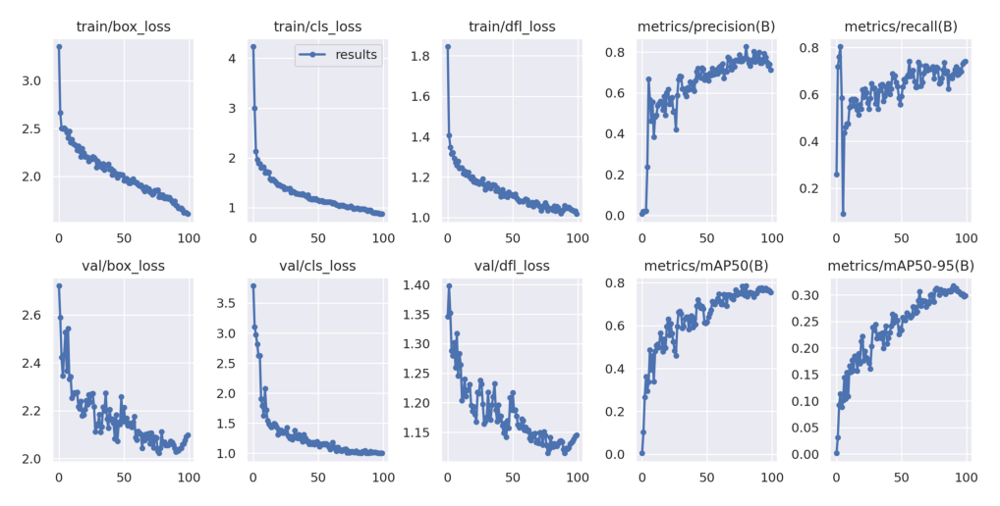

In [36]:
imShow('/content/runs/detect/train/results.png')

#**DETECTION**
Run inference with a pretrained checkpoint on contents of `test/images` folder.

In [37]:
# validation
!yolo task=detect mode=val model=/content/runs/detect/train/weights/best.pt data=data/data.yaml


Ultralytics YOLOv8.0.30 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /content/data/val/labels.cache... 32 images, 0 backgrounds, 0 corrupt: 100% 32/32 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 2/2 [00:04<00:00,  2.19s/it]
                   all         32        255      0.796       0.69      0.768       0.32
Speed: 0.2ms pre-process, 5.7ms inference, 0.0ms loss, 1.1ms post-process per image


In [40]:
#Inference
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.25 source=data/test/images save= True

Ultralytics YOLOv8.0.30 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs

image 1/32 /content/data/test/images/m13-m14-0031.jpg: 480x640 9 maiz14s, 14.5ms
image 2/32 /content/data/test/images/m13-m14-0055.jpg: 480x640 10 maiz14s, 9.9ms
image 3/32 /content/data/test/images/m13-m14-0073.jpg: 480x640 10 maiz14s, 9.8ms
image 4/32 /content/data/test/images/m13-m14-0106.jpg: 480x640 9 maiz14s, 15.8ms
image 5/32 /content/data/test/images/m13-m14-0251.jpg: 480x640 4 maiz14s, 10.2ms
image 6/32 /content/data/test/images/m13-m14-0396.jpg: 480x640 6 maiz14s, 9.8ms
image 7/32 /content/data/test/images/m13-m14-0421.jpg: 480x640 9 maiz14s, 10.1ms
image 8/32 /content/data/test/images/m13-m14-1003.jpg: 480x640 18 maiz14s, 10.0ms
image 9/32 /content/data/test/images/m13-m14-1009.jpg: 480x640 21 maiz14s, 10.0ms
image 10/32 /content/data/test/images/m13-m14-1197.jpg: 480x640 5 maiz14s, 10.1ms
image 11/32 /content/

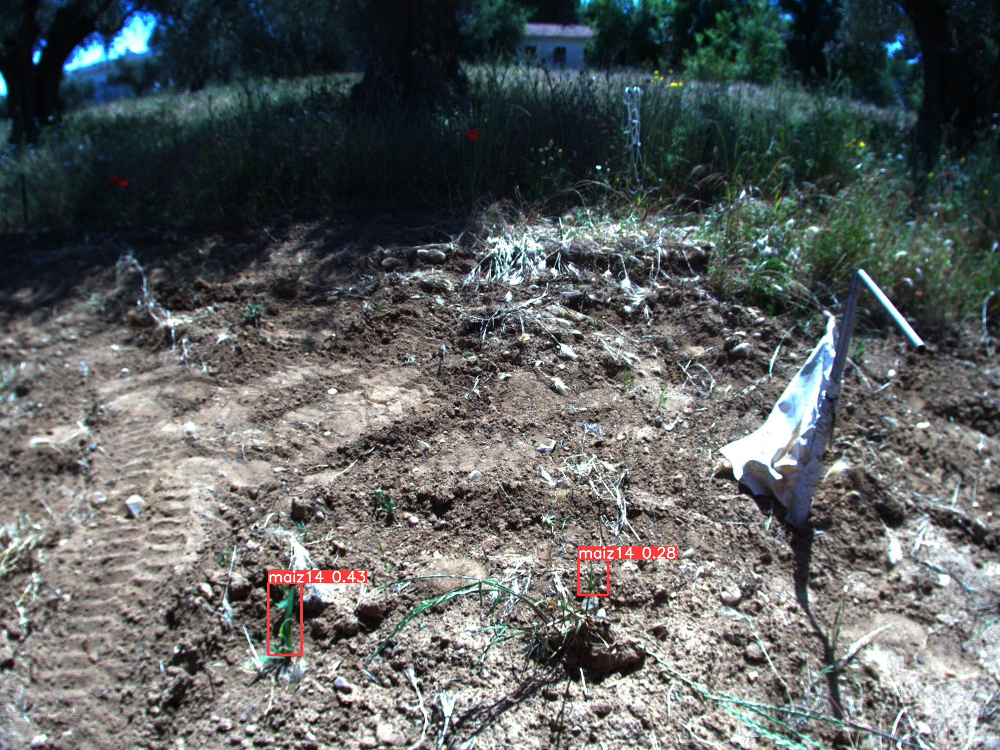

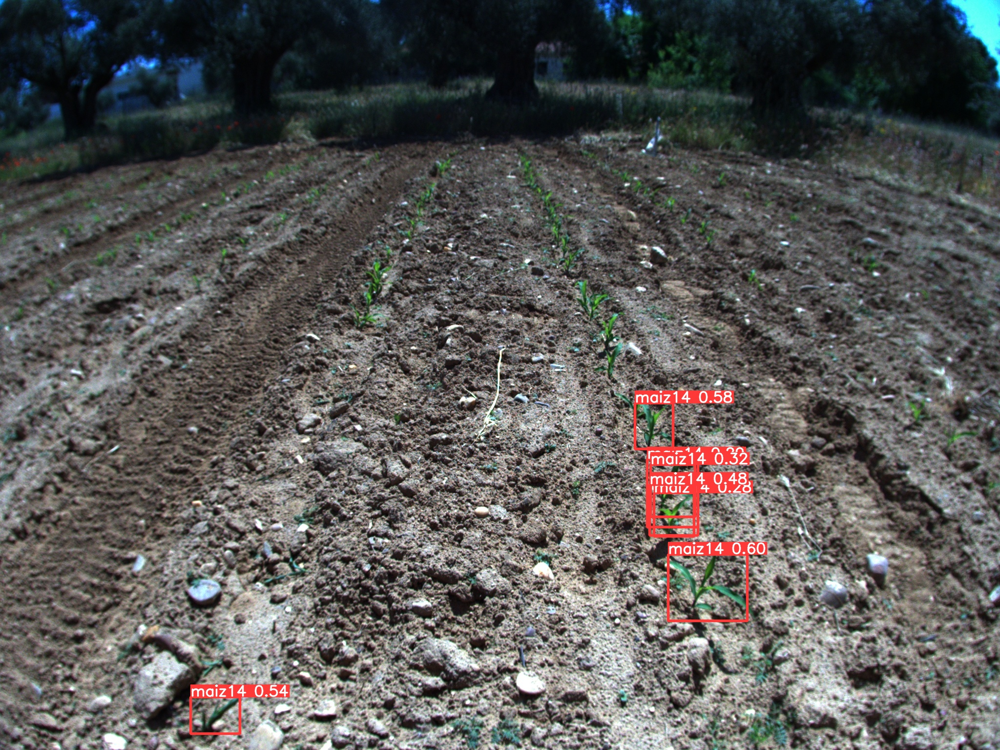

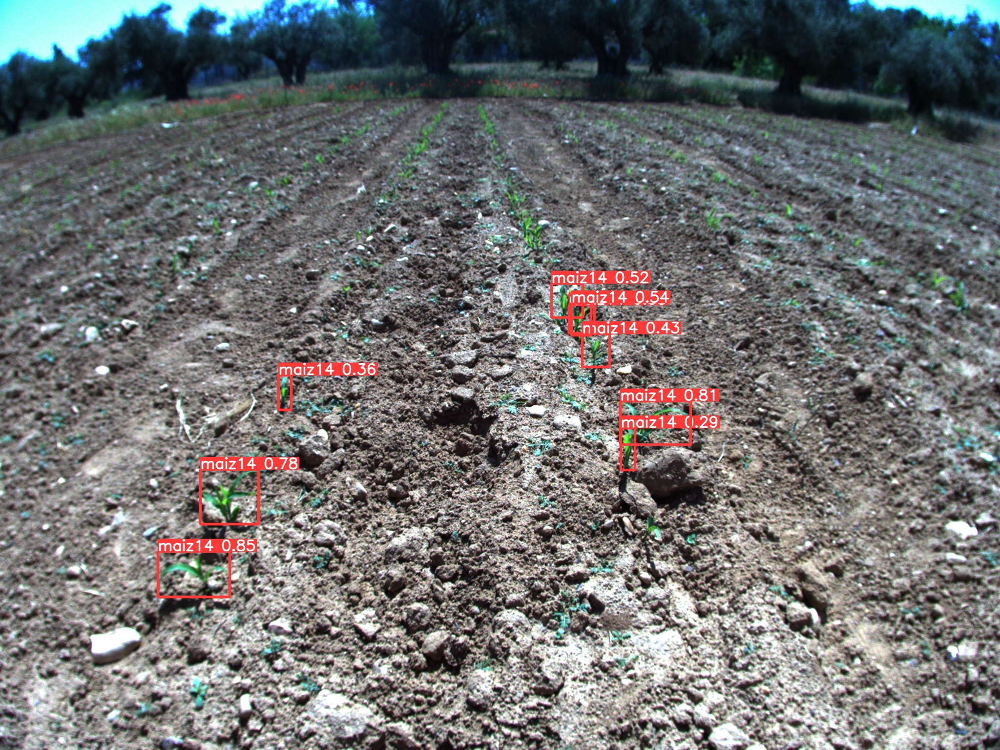

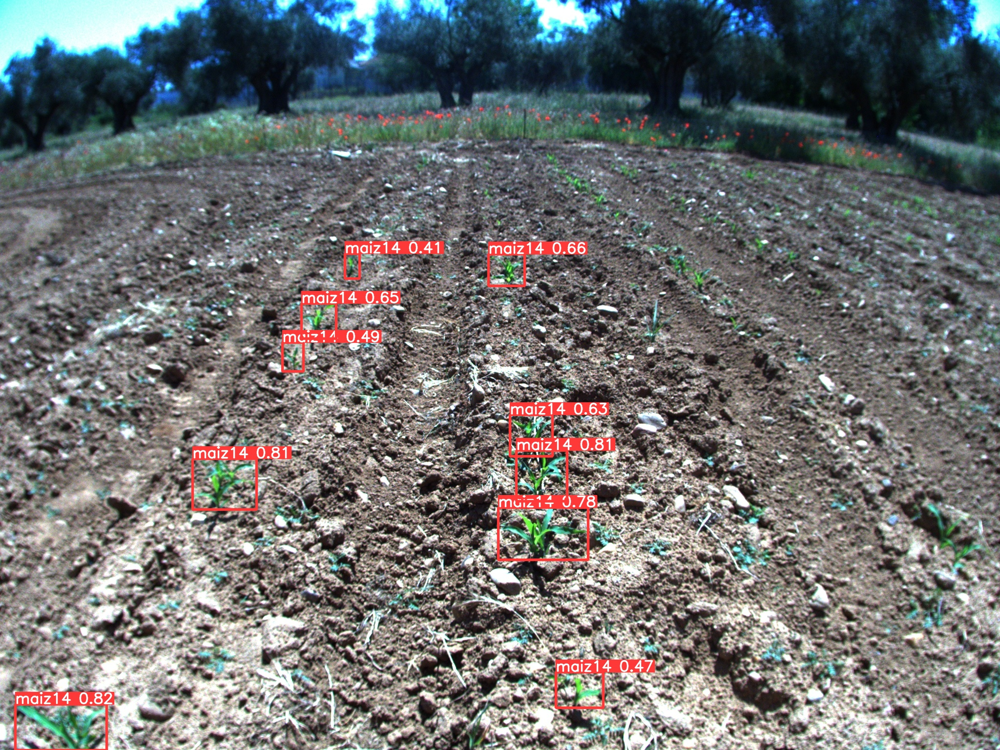

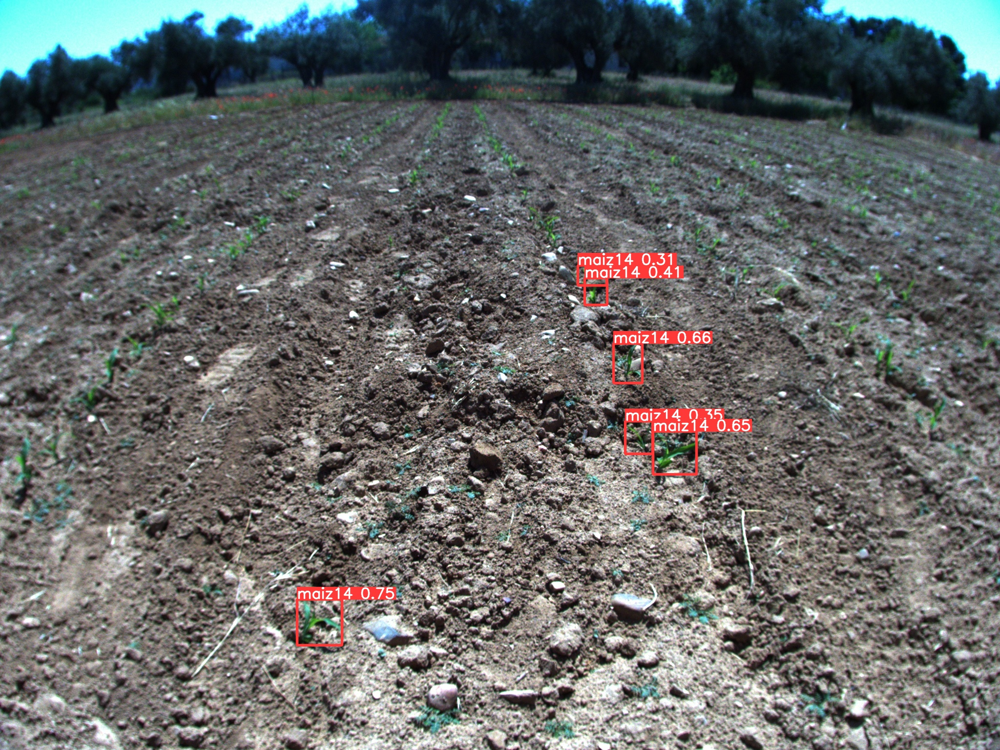

In [41]:
#display inference on some test images

import glob
from IPython.display import Image, display

i = 7  #inicial image to print
limit = i + 5 # max images to print
for imageName in glob.glob('runs/detect/predict2/*.jpg'): #assuming JPG
    if i < limit:
      display(Image(filename=imageName))
      print("\n\n")
    i = i + 1

We'll run the detection into one specific image

In [43]:
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.25 source=/content/gdrive/MyDrive/yolov5/m13-m14-1410.jpg save= True

Ultralytics YOLOv8.0.30 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs

image 1/1 /content/gdrive/MyDrive/yolov5/m13-m14-1410.jpg: 480x640 14 maiz14s, 14.5ms
Speed: 0.7ms pre-process, 14.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict3


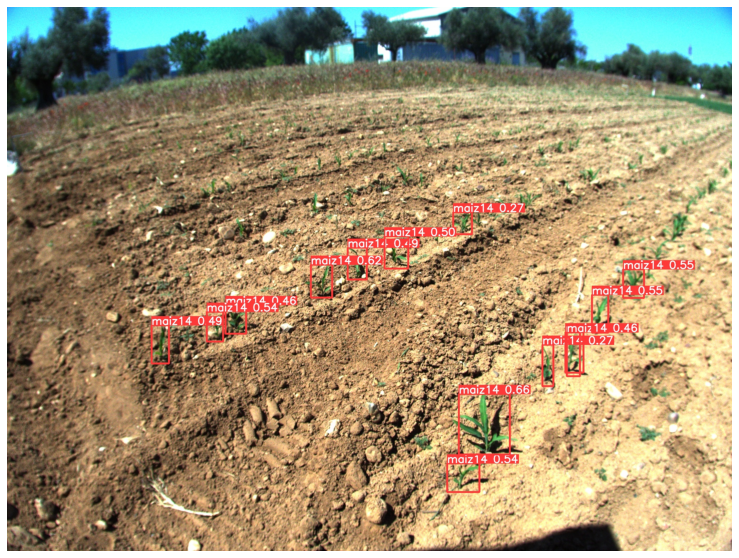

In [44]:
imShow ('runs/detect/predict3/m13-m14-1410.jpg')

# SAVE
Save into Drive, metrics, weight and results

In [45]:
#copy the results into Drive for future use
!cp -av runs /mydrive/yolov8/runs

'runs' -> '/mydrive/yolov8/runs/runs'
'runs/detect' -> '/mydrive/yolov8/runs/runs/detect'
'runs/detect/train' -> '/mydrive/yolov8/runs/runs/detect/train'
'runs/detect/train/weights' -> '/mydrive/yolov8/runs/runs/detect/train/weights'
'runs/detect/train/weights/last.pt' -> '/mydrive/yolov8/runs/runs/detect/train/weights/last.pt'
'runs/detect/train/weights/best.pt' -> '/mydrive/yolov8/runs/runs/detect/train/weights/best.pt'
'runs/detect/train/args.yaml' -> '/mydrive/yolov8/runs/runs/detect/train/args.yaml'
'runs/detect/train/events.out.tfevents.1675789725.9e17a9a30fa5.8683.0' -> '/mydrive/yolov8/runs/runs/detect/train/events.out.tfevents.1675789725.9e17a9a30fa5.8683.0'
'runs/detect/train/results.csv' -> '/mydrive/yolov8/runs/runs/detect/train/results.csv'
'runs/detect/train/PR_curve.png' -> '/mydrive/yolov8/runs/runs/detect/train/PR_curve.png'
'runs/detect/train/train_batch0.jpg' -> '/mydrive/yolov8/runs/runs/detect/train/train_batch0.jpg'
'runs/detect/train/train_batch1.jpg' -> '/mydriv